# Objective
* Review camera locations in Calgary and find correlation to accident counts

# Import Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import Grid_Analysis as ga
import Accidents as acc
print("check")

check


Include Sign Functions to be exported to its own py file later

In [3]:
#Load the Traffic_Sign.csv and take only sign count and point rows. Send back a df
def get_sign_df():
    print("entering add_sign_df")
    """
    Reads Traffic_Signs.csv into df keeping only count and coordinate columns
    :return: df of Traffic Signs with only count and coordinate columns
    """
    df_signs = pd.read_csv("Traffic_Signs.csv")
    data = [df_signs["SGN_COUNT_NO"], df_signs["POINT"]]
    headers =["count",'coordinate']
    res = pd.concat(data, axis=1, keys=headers)
    return res

In [4]:
#Takes coordinate data from sign df and adds two columns longitude and lattitude (float)
def add_sign_latlong(df_signs):
    print("entering add_sign_latlong")
    """
    Adds the longitude and lattitude columns to the Traffic Signs dataframe using the coordinate column
    :param df_signs: a dataframe with columns longitude and latitude
    :return: an updated dataframe with columns longitude and latitude
    """
    df=df_signs
    df["coordinate"]=df["coordinate"].apply(lambda x: str(x).replace("POINT (","")).replace(")","")
    df["coordinate"]=df["coordinate"].apply(lambda x: str(x).split(' '))
    df[['longitude','latitude']] = pd.DataFrame(df.coordinate.tolist(), index= df.index)
    df['longitude'] = df['longitude'].str.strip('[]()').astype(float)
    df['latitude'] = df['latitude'].str.strip('[]()').astype(float)
    return df

In [ ]:
print("check")
df_sign = get_sign_df()
df_sign = add_sign_latlong(df_sign)
print("check")

df_sign

# Import Sign DataSet

In [3]:
df = pd.read_csv("Traffic_Signs.csv")
df['BLADE_TYPE'].value_counts()

Street Name             42762
Parking Restrictions    33794
Regulatory              23315
Warning                 17953
Stop                    12856
Timed Parking           10682
Playground               9743
Yield                    9406
Pedestrian               8908
Guide / Information      7588
Residential Parking      5875
Disabled Parking         4522
Speed                    4355
Bicycle / Pathway        4199
Park Plus                3808
Snow Route               2761
Loading Zone             2141
School                   2019
Overhead Guide            450
Hospital                  139
Halo                       10
Name: BLADE_TYPE, dtype: int64

In [4]:
#Drop unimportant signs, keep only necessary columns, reset index.

df=df[df['BLADE_TYPE'].isin(['Speed','School','Playground','Yield','Stop'])]
data=[df.BLADE_TYPE,df.SGN_COUNT_NO,df.POINT]
df = pd.concat(data,axis=1)
df= df.rename(columns={'BLADE_TYPE':"sign_type", 'SGN_COUNT_NO':'sign_count','POINT':'coordinate'})
df= df.reset_index(drop=True)
df

,sign_type,sign_count,coordinate
0,Yield,0.0,POINT (-114.094374668366 50.97932823916)
1,Stop,2.0,POINT (-114.050415908751 51.047132018374)
2,Stop,0.0,POINT (-114.109678007362 51.023129992642)
3,Stop,4.0,POINT (-114.050685051172 51.047205670797)
4,Yield,0.0,POINT (-114.09441056135 50.979431963661)
...,...,...,...
38374,Stop,3.0,POINT (-114.197288584804 51.093980736144)
38375,Stop,2.0,POINT (-114.048354211088 51.090142270424)
38376,Playground,1.0,POINT (-114.216564811046 51.059319356325)
38377,Speed,1.0,POINT (-113.958452740811 50.969602409926)


In [5]:
#Condition coordinate data such that the format is string : lat long to use ga.methods
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).replace("POINT (","")).replace(")","")
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).strip(')'))
df

,sign_type,sign_count,coordinate
0,Yield,0.0,-114.094374668366 50.97932823916
1,Stop,2.0,-114.050415908751 51.047132018374
2,Stop,0.0,-114.109678007362 51.023129992642
3,Stop,4.0,-114.050685051172 51.047205670797
4,Yield,0.0,-114.09441056135 50.979431963661
...,...,...,...
38374,Stop,3.0,-114.197288584804 51.093980736144
38375,Stop,2.0,-114.048354211088 51.090142270424
38376,Playground,1.0,-114.216564811046 51.059319356325
38377,Speed,1.0,-113.958452740811 50.969602409926


In [6]:
#Create longitude and latitude columns for ploting distribution
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).split(' '))
df[['longitude','latitude']] = pd.DataFrame(df.coordinate.tolist(), index= df.index)
df['longitude'] = df['longitude'].str.strip('[]()').astype(float)
df['latitude'] = df['latitude'].str.strip('[]()').astype(float)
df

,sign_type,sign_count,coordinate,longitude,latitude
0,Yield,0.0,"[-114.094374668366, 50.97932823916]",-114.094375,50.979328
1,Stop,2.0,"[-114.050415908751, 51.047132018374]",-114.050416,51.047132
2,Stop,0.0,"[-114.109678007362, 51.023129992642]",-114.109678,51.023130
3,Stop,4.0,"[-114.050685051172, 51.047205670797]",-114.050685,51.047206
4,Yield,0.0,"[-114.09441056135, 50.979431963661]",-114.094411,50.979432
...,...,...,...,...,...
38374,Stop,3.0,"[-114.197288584804, 51.093980736144]",-114.197289,51.093981
38375,Stop,2.0,"[-114.048354211088, 51.090142270424]",-114.048354,51.090142
38376,Playground,1.0,"[-114.216564811046, 51.059319356325]",-114.216565,51.059319
38377,Speed,1.0,"[-113.958452740811, 50.969602409926]",-113.958453,50.969602


# Analyze

## Distribution of Traffic Signs

In [7]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

sign_cluster = MarkerCluster().add_to(map)

for idx, row in df.iterrows():
    print("processing:", idx)
    folium.Marker([row['latitude'], row['longitude']],
                 popup='sign').add_to(sign_cluster)
print("check")
map

processing: 0
processing: 1
processing: 2
processing: 3
processing: 4
processing: 5
processing: 6
processing: 7
processing: 8
processing: 9
processing: 10
processing: 11
processing: 12
processing: 13
processing: 14
processing: 15
processing: 16
processing: 17
processing: 18
processing: 19
processing: 20
processing: 21
processing: 22
processing: 23
processing: 24
processing: 25
processing: 26
processing: 27
processing: 28
processing: 29
processing: 30
processing: 31
processing: 32
processing: 33
processing: 34
processing: 35
processing: 36
processing: 37
processing: 38
processing: 39
processing: 40
processing: 41
processing: 42
processing: 43
processing: 44
processing: 45
processing: 46
processing: 47
processing: 48
processing: 49
processing: 50
processing: 51
processing: 52
processing: 53
processing: 54
processing: 55
processing: 56
processing: 57
processing: 58
processing: 59
processing: 60
processing: 61
processing: 62
processing: 63
processing: 64
processing: 65
processing: 66
proce

processing: 843
processing: 844
processing: 845
processing: 846
processing: 847
processing: 848
processing: 849
processing: 850
processing: 851
processing: 852
processing: 853
processing: 854
processing: 855
processing: 856
processing: 857
processing: 858
processing: 859
processing: 860
processing: 861
processing: 862
processing: 863
processing: 864
processing: 865
processing: 866
processing: 867
processing: 868
processing: 869
processing: 870
processing: 871
processing: 872
processing: 873
processing: 874
processing: 875
processing: 876
processing: 877
processing: 878
processing: 879
processing: 880
processing: 881
processing: 882
processing: 883
processing: 884
processing: 885
processing: 886
processing: 887
processing: 888
processing: 889
processing: 890
processing: 891
processing: 892
processing: 893
processing: 894
processing: 895
processing: 896
processing: 897
processing: 898
processing: 899
processing: 900
processing: 901
processing: 902
processing: 903
processing: 904
processi

processing: 1668
processing: 1669
processing: 1670
processing: 1671
processing: 1672
processing: 1673
processing: 1674
processing: 1675
processing: 1676
processing: 1677
processing: 1678
processing: 1679
processing: 1680
processing: 1681
processing: 1682
processing: 1683
processing: 1684
processing: 1685
processing: 1686
processing: 1687
processing: 1688
processing: 1689
processing: 1690
processing: 1691
processing: 1692
processing: 1693
processing: 1694
processing: 1695
processing: 1696
processing: 1697
processing: 1698
processing: 1699
processing: 1700
processing: 1701
processing: 1702
processing: 1703
processing: 1704
processing: 1705
processing: 1706
processing: 1707
processing: 1708
processing: 1709
processing: 1710
processing: 1711
processing: 1712
processing: 1713
processing: 1714
processing: 1715
processing: 1716
processing: 1717
processing: 1718
processing: 1719
processing: 1720
processing: 1721
processing: 1722
processing: 1723
processing: 1724
processing: 1725
processing: 17

processing: 2468
processing: 2469
processing: 2470
processing: 2471
processing: 2472
processing: 2473
processing: 2474
processing: 2475
processing: 2476
processing: 2477
processing: 2478
processing: 2479
processing: 2480
processing: 2481
processing: 2482
processing: 2483
processing: 2484
processing: 2485
processing: 2486
processing: 2487
processing: 2488
processing: 2489
processing: 2490
processing: 2491
processing: 2492
processing: 2493
processing: 2494
processing: 2495
processing: 2496
processing: 2497
processing: 2498
processing: 2499
processing: 2500
processing: 2501
processing: 2502
processing: 2503
processing: 2504
processing: 2505
processing: 2506
processing: 2507
processing: 2508
processing: 2509
processing: 2510
processing: 2511
processing: 2512
processing: 2513
processing: 2514
processing: 2515
processing: 2516
processing: 2517
processing: 2518
processing: 2519
processing: 2520
processing: 2521
processing: 2522
processing: 2523
processing: 2524
processing: 2525
processing: 25

processing: 3118
processing: 3119
processing: 3120
processing: 3121
processing: 3122
processing: 3123
processing: 3124
processing: 3125
processing: 3126
processing: 3127
processing: 3128
processing: 3129
processing: 3130
processing: 3131
processing: 3132
processing: 3133
processing: 3134
processing: 3135
processing: 3136
processing: 3137
processing: 3138
processing: 3139
processing: 3140
processing: 3141
processing: 3142
processing: 3143
processing: 3144
processing: 3145
processing: 3146
processing: 3147
processing: 3148
processing: 3149
processing: 3150
processing: 3151
processing: 3152
processing: 3153
processing: 3154
processing: 3155
processing: 3156
processing: 3157
processing: 3158
processing: 3159
processing: 3160
processing: 3161
processing: 3162
processing: 3163
processing: 3164
processing: 3165
processing: 3166
processing: 3167
processing: 3168
processing: 3169
processing: 3170
processing: 3171
processing: 3172
processing: 3173
processing: 3174
processing: 3175
processing: 31

processing: 3877
processing: 3878
processing: 3879
processing: 3880
processing: 3881
processing: 3882
processing: 3883
processing: 3884
processing: 3885
processing: 3886
processing: 3887
processing: 3888
processing: 3889
processing: 3890
processing: 3891
processing: 3892
processing: 3893
processing: 3894
processing: 3895
processing: 3896
processing: 3897
processing: 3898
processing: 3899
processing: 3900
processing: 3901
processing: 3902
processing: 3903
processing: 3904
processing: 3905
processing: 3906
processing: 3907
processing: 3908
processing: 3909
processing: 3910
processing: 3911
processing: 3912
processing: 3913
processing: 3914
processing: 3915
processing: 3916
processing: 3917
processing: 3918
processing: 3919
processing: 3920
processing: 3921
processing: 3922
processing: 3923
processing: 3924
processing: 3925
processing: 3926
processing: 3927
processing: 3928
processing: 3929
processing: 3930
processing: 3931
processing: 3932
processing: 3933
processing: 3934
processing: 39

processing: 4659
processing: 4660
processing: 4661
processing: 4662
processing: 4663
processing: 4664
processing: 4665
processing: 4666
processing: 4667
processing: 4668
processing: 4669
processing: 4670
processing: 4671
processing: 4672
processing: 4673
processing: 4674
processing: 4675
processing: 4676
processing: 4677
processing: 4678
processing: 4679
processing: 4680
processing: 4681
processing: 4682
processing: 4683
processing: 4684
processing: 4685
processing: 4686
processing: 4687
processing: 4688
processing: 4689
processing: 4690
processing: 4691
processing: 4692
processing: 4693
processing: 4694
processing: 4695
processing: 4696
processing: 4697
processing: 4698
processing: 4699
processing: 4700
processing: 4701
processing: 4702
processing: 4703
processing: 4704
processing: 4705
processing: 4706
processing: 4707
processing: 4708
processing: 4709
processing: 4710
processing: 4711
processing: 4712
processing: 4713
processing: 4714
processing: 4715
processing: 4716
processing: 47

processing: 5485
processing: 5486
processing: 5487
processing: 5488
processing: 5489
processing: 5490
processing: 5491
processing: 5492
processing: 5493
processing: 5494
processing: 5495
processing: 5496
processing: 5497
processing: 5498
processing: 5499
processing: 5500
processing: 5501
processing: 5502
processing: 5503
processing: 5504
processing: 5505
processing: 5506
processing: 5507
processing: 5508
processing: 5509
processing: 5510
processing: 5511
processing: 5512
processing: 5513
processing: 5514
processing: 5515
processing: 5516
processing: 5517
processing: 5518
processing: 5519
processing: 5520
processing: 5521
processing: 5522
processing: 5523
processing: 5524
processing: 5525
processing: 5526
processing: 5527
processing: 5528
processing: 5529
processing: 5530
processing: 5531
processing: 5532
processing: 5533
processing: 5534
processing: 5535
processing: 5536
processing: 5537
processing: 5538
processing: 5539
processing: 5540
processing: 5541
processing: 5542
processing: 55

processing: 6325
processing: 6326
processing: 6327
processing: 6328
processing: 6329
processing: 6330
processing: 6331
processing: 6332
processing: 6333
processing: 6334
processing: 6335
processing: 6336
processing: 6337
processing: 6338
processing: 6339
processing: 6340
processing: 6341
processing: 6342
processing: 6343
processing: 6344
processing: 6345
processing: 6346
processing: 6347
processing: 6348
processing: 6349
processing: 6350
processing: 6351
processing: 6352
processing: 6353
processing: 6354
processing: 6355
processing: 6356
processing: 6357
processing: 6358
processing: 6359
processing: 6360
processing: 6361
processing: 6362
processing: 6363
processing: 6364
processing: 6365
processing: 6366
processing: 6367
processing: 6368
processing: 6369
processing: 6370
processing: 6371
processing: 6372
processing: 6373
processing: 6374
processing: 6375
processing: 6376
processing: 6377
processing: 6378
processing: 6379
processing: 6380
processing: 6381
processing: 6382
processing: 63

processing: 6965
processing: 6966
processing: 6967
processing: 6968
processing: 6969
processing: 6970
processing: 6971
processing: 6972
processing: 6973
processing: 6974
processing: 6975
processing: 6976
processing: 6977
processing: 6978
processing: 6979
processing: 6980
processing: 6981
processing: 6982
processing: 6983
processing: 6984
processing: 6985
processing: 6986
processing: 6987
processing: 6988
processing: 6989
processing: 6990
processing: 6991
processing: 6992
processing: 6993
processing: 6994
processing: 6995
processing: 6996
processing: 6997
processing: 6998
processing: 6999
processing: 7000
processing: 7001
processing: 7002
processing: 7003
processing: 7004
processing: 7005
processing: 7006
processing: 7007
processing: 7008
processing: 7009
processing: 7010
processing: 7011
processing: 7012
processing: 7013
processing: 7014
processing: 7015
processing: 7016
processing: 7017
processing: 7018
processing: 7019
processing: 7020
processing: 7021
processing: 7022
processing: 70

processing: 7821
processing: 7822
processing: 7823
processing: 7824
processing: 7825
processing: 7826
processing: 7827
processing: 7828
processing: 7829
processing: 7830
processing: 7831
processing: 7832
processing: 7833
processing: 7834
processing: 7835
processing: 7836
processing: 7837
processing: 7838
processing: 7839
processing: 7840
processing: 7841
processing: 7842
processing: 7843
processing: 7844
processing: 7845
processing: 7846
processing: 7847
processing: 7848
processing: 7849
processing: 7850
processing: 7851
processing: 7852
processing: 7853
processing: 7854
processing: 7855
processing: 7856
processing: 7857
processing: 7858
processing: 7859
processing: 7860
processing: 7861
processing: 7862
processing: 7863
processing: 7864
processing: 7865
processing: 7866
processing: 7867
processing: 7868
processing: 7869
processing: 7870
processing: 7871
processing: 7872
processing: 7873
processing: 7874
processing: 7875
processing: 7876
processing: 7877
processing: 7878
processing: 78

processing: 8565
processing: 8566
processing: 8567
processing: 8568
processing: 8569
processing: 8570
processing: 8571
processing: 8572
processing: 8573
processing: 8574
processing: 8575
processing: 8576
processing: 8577
processing: 8578
processing: 8579
processing: 8580
processing: 8581
processing: 8582
processing: 8583
processing: 8584
processing: 8585
processing: 8586
processing: 8587
processing: 8588
processing: 8589
processing: 8590
processing: 8591
processing: 8592
processing: 8593
processing: 8594
processing: 8595
processing: 8596
processing: 8597
processing: 8598
processing: 8599
processing: 8600
processing: 8601
processing: 8602
processing: 8603
processing: 8604
processing: 8605
processing: 8606
processing: 8607
processing: 8608
processing: 8609
processing: 8610
processing: 8611
processing: 8612
processing: 8613
processing: 8614
processing: 8615
processing: 8616
processing: 8617
processing: 8618
processing: 8619
processing: 8620
processing: 8621
processing: 8622
processing: 86

processing: 9290
processing: 9291
processing: 9292
processing: 9293
processing: 9294
processing: 9295
processing: 9296
processing: 9297
processing: 9298
processing: 9299
processing: 9300
processing: 9301
processing: 9302
processing: 9303
processing: 9304
processing: 9305
processing: 9306
processing: 9307
processing: 9308
processing: 9309
processing: 9310
processing: 9311
processing: 9312
processing: 9313
processing: 9314
processing: 9315
processing: 9316
processing: 9317
processing: 9318
processing: 9319
processing: 9320
processing: 9321
processing: 9322
processing: 9323
processing: 9324
processing: 9325
processing: 9326
processing: 9327
processing: 9328
processing: 9329
processing: 9330
processing: 9331
processing: 9332
processing: 9333
processing: 9334
processing: 9335
processing: 9336
processing: 9337
processing: 9338
processing: 9339
processing: 9340
processing: 9341
processing: 9342
processing: 9343
processing: 9344
processing: 9345
processing: 9346
processing: 9347
processing: 93

processing: 10213
processing: 10214
processing: 10215
processing: 10216
processing: 10217
processing: 10218
processing: 10219
processing: 10220
processing: 10221
processing: 10222
processing: 10223
processing: 10224
processing: 10225
processing: 10226
processing: 10227
processing: 10228
processing: 10229
processing: 10230
processing: 10231
processing: 10232
processing: 10233
processing: 10234
processing: 10235
processing: 10236
processing: 10237
processing: 10238
processing: 10239
processing: 10240
processing: 10241
processing: 10242
processing: 10243
processing: 10244
processing: 10245
processing: 10246
processing: 10247
processing: 10248
processing: 10249
processing: 10250
processing: 10251
processing: 10252
processing: 10253
processing: 10254
processing: 10255
processing: 10256
processing: 10257
processing: 10258
processing: 10259
processing: 10260
processing: 10261
processing: 10262
processing: 10263
processing: 10264
processing: 10265
processing: 10266
processing: 10267
processing

processing: 11028
processing: 11029
processing: 11030
processing: 11031
processing: 11032
processing: 11033
processing: 11034
processing: 11035
processing: 11036
processing: 11037
processing: 11038
processing: 11039
processing: 11040
processing: 11041
processing: 11042
processing: 11043
processing: 11044
processing: 11045
processing: 11046
processing: 11047
processing: 11048
processing: 11049
processing: 11050
processing: 11051
processing: 11052
processing: 11053
processing: 11054
processing: 11055
processing: 11056
processing: 11057
processing: 11058
processing: 11059
processing: 11060
processing: 11061
processing: 11062
processing: 11063
processing: 11064
processing: 11065
processing: 11066
processing: 11067
processing: 11068
processing: 11069
processing: 11070
processing: 11071
processing: 11072
processing: 11073
processing: 11074
processing: 11075
processing: 11076
processing: 11077
processing: 11078
processing: 11079
processing: 11080
processing: 11081
processing: 11082
processing

processing: 11680
processing: 11681
processing: 11682
processing: 11683
processing: 11684
processing: 11685
processing: 11686
processing: 11687
processing: 11688
processing: 11689
processing: 11690
processing: 11691
processing: 11692
processing: 11693
processing: 11694
processing: 11695
processing: 11696
processing: 11697
processing: 11698
processing: 11699
processing: 11700
processing: 11701
processing: 11702
processing: 11703
processing: 11704
processing: 11705
processing: 11706
processing: 11707
processing: 11708
processing: 11709
processing: 11710
processing: 11711
processing: 11712
processing: 11713
processing: 11714
processing: 11715
processing: 11716
processing: 11717
processing: 11718
processing: 11719
processing: 11720
processing: 11721
processing: 11722
processing: 11723
processing: 11724
processing: 11725
processing: 11726
processing: 11727
processing: 11728
processing: 11729
processing: 11730
processing: 11731
processing: 11732
processing: 11733
processing: 11734
processing

processing: 12457
processing: 12458
processing: 12459
processing: 12460
processing: 12461
processing: 12462
processing: 12463
processing: 12464
processing: 12465
processing: 12466
processing: 12467
processing: 12468
processing: 12469
processing: 12470
processing: 12471
processing: 12472
processing: 12473
processing: 12474
processing: 12475
processing: 12476
processing: 12477
processing: 12478
processing: 12479
processing: 12480
processing: 12481
processing: 12482
processing: 12483
processing: 12484
processing: 12485
processing: 12486
processing: 12487
processing: 12488
processing: 12489
processing: 12490
processing: 12491
processing: 12492
processing: 12493
processing: 12494
processing: 12495
processing: 12496
processing: 12497
processing: 12498
processing: 12499
processing: 12500
processing: 12501
processing: 12502
processing: 12503
processing: 12504
processing: 12505
processing: 12506
processing: 12507
processing: 12508
processing: 12509
processing: 12510
processing: 12511
processing

processing: 13261
processing: 13262
processing: 13263
processing: 13264
processing: 13265
processing: 13266
processing: 13267
processing: 13268
processing: 13269
processing: 13270
processing: 13271
processing: 13272
processing: 13273
processing: 13274
processing: 13275
processing: 13276
processing: 13277
processing: 13278
processing: 13279
processing: 13280
processing: 13281
processing: 13282
processing: 13283
processing: 13284
processing: 13285
processing: 13286
processing: 13287
processing: 13288
processing: 13289
processing: 13290
processing: 13291
processing: 13292
processing: 13293
processing: 13294
processing: 13295
processing: 13296
processing: 13297
processing: 13298
processing: 13299
processing: 13300
processing: 13301
processing: 13302
processing: 13303
processing: 13304
processing: 13305
processing: 13306
processing: 13307
processing: 13308
processing: 13309
processing: 13310
processing: 13311
processing: 13312
processing: 13313
processing: 13314
processing: 13315
processing

processing: 14099
processing: 14100
processing: 14101
processing: 14102
processing: 14103
processing: 14104
processing: 14105
processing: 14106
processing: 14107
processing: 14108
processing: 14109
processing: 14110
processing: 14111
processing: 14112
processing: 14113
processing: 14114
processing: 14115
processing: 14116
processing: 14117
processing: 14118
processing: 14119
processing: 14120
processing: 14121
processing: 14122
processing: 14123
processing: 14124
processing: 14125
processing: 14126
processing: 14127
processing: 14128
processing: 14129
processing: 14130
processing: 14131
processing: 14132
processing: 14133
processing: 14134
processing: 14135
processing: 14136
processing: 14137
processing: 14138
processing: 14139
processing: 14140
processing: 14141
processing: 14142
processing: 14143
processing: 14144
processing: 14145
processing: 14146
processing: 14147
processing: 14148
processing: 14149
processing: 14150
processing: 14151
processing: 14152
processing: 14153
processing

processing: 14939
processing: 14940
processing: 14941
processing: 14942
processing: 14943
processing: 14944
processing: 14945
processing: 14946
processing: 14947
processing: 14948
processing: 14949
processing: 14950
processing: 14951
processing: 14952
processing: 14953
processing: 14954
processing: 14955
processing: 14956
processing: 14957
processing: 14958
processing: 14959
processing: 14960
processing: 14961
processing: 14962
processing: 14963
processing: 14964
processing: 14965
processing: 14966
processing: 14967
processing: 14968
processing: 14969
processing: 14970
processing: 14971
processing: 14972
processing: 14973
processing: 14974
processing: 14975
processing: 14976
processing: 14977
processing: 14978
processing: 14979
processing: 14980
processing: 14981
processing: 14982
processing: 14983
processing: 14984
processing: 14985
processing: 14986
processing: 14987
processing: 14988
processing: 14989
processing: 14990
processing: 14991
processing: 14992
processing: 14993
processing

processing: 15689
processing: 15690
processing: 15691
processing: 15692
processing: 15693
processing: 15694
processing: 15695
processing: 15696
processing: 15697
processing: 15698
processing: 15699
processing: 15700
processing: 15701
processing: 15702
processing: 15703
processing: 15704
processing: 15705
processing: 15706
processing: 15707
processing: 15708
processing: 15709
processing: 15710
processing: 15711
processing: 15712
processing: 15713
processing: 15714
processing: 15715
processing: 15716
processing: 15717
processing: 15718
processing: 15719
processing: 15720
processing: 15721
processing: 15722
processing: 15723
processing: 15724
processing: 15725
processing: 15726
processing: 15727
processing: 15728
processing: 15729
processing: 15730
processing: 15731
processing: 15732
processing: 15733
processing: 15734
processing: 15735
processing: 15736
processing: 15737
processing: 15738
processing: 15739
processing: 15740
processing: 15741
processing: 15742
processing: 15743
processing

processing: 16440
processing: 16441
processing: 16442
processing: 16443
processing: 16444
processing: 16445
processing: 16446
processing: 16447
processing: 16448
processing: 16449
processing: 16450
processing: 16451
processing: 16452
processing: 16453
processing: 16454
processing: 16455
processing: 16456
processing: 16457
processing: 16458
processing: 16459
processing: 16460
processing: 16461
processing: 16462
processing: 16463
processing: 16464
processing: 16465
processing: 16466
processing: 16467
processing: 16468
processing: 16469
processing: 16470
processing: 16471
processing: 16472
processing: 16473
processing: 16474
processing: 16475
processing: 16476
processing: 16477
processing: 16478
processing: 16479
processing: 16480
processing: 16481
processing: 16482
processing: 16483
processing: 16484
processing: 16485
processing: 16486
processing: 16487
processing: 16488
processing: 16489
processing: 16490
processing: 16491
processing: 16492
processing: 16493
processing: 16494
processing

processing: 17174
processing: 17175
processing: 17176
processing: 17177
processing: 17178
processing: 17179
processing: 17180
processing: 17181
processing: 17182
processing: 17183
processing: 17184
processing: 17185
processing: 17186
processing: 17187
processing: 17188
processing: 17189
processing: 17190
processing: 17191
processing: 17192
processing: 17193
processing: 17194
processing: 17195
processing: 17196
processing: 17197
processing: 17198
processing: 17199
processing: 17200
processing: 17201
processing: 17202
processing: 17203
processing: 17204
processing: 17205
processing: 17206
processing: 17207
processing: 17208
processing: 17209
processing: 17210
processing: 17211
processing: 17212
processing: 17213
processing: 17214
processing: 17215
processing: 17216
processing: 17217
processing: 17218
processing: 17219
processing: 17220
processing: 17221
processing: 17222
processing: 17223
processing: 17224
processing: 17225
processing: 17226
processing: 17227
processing: 17228
processing

processing: 17644
processing: 17645
processing: 17646
processing: 17647
processing: 17648
processing: 17649
processing: 17650
processing: 17651
processing: 17652
processing: 17653
processing: 17654
processing: 17655
processing: 17656
processing: 17657
processing: 17658
processing: 17659
processing: 17660
processing: 17661
processing: 17662
processing: 17663
processing: 17664
processing: 17665
processing: 17666
processing: 17667
processing: 17668
processing: 17669
processing: 17670
processing: 17671
processing: 17672
processing: 17673
processing: 17674
processing: 17675
processing: 17676
processing: 17677
processing: 17678
processing: 17679
processing: 17680
processing: 17681
processing: 17682
processing: 17683
processing: 17684
processing: 17685
processing: 17686
processing: 17687
processing: 17688
processing: 17689
processing: 17690
processing: 17691
processing: 17692
processing: 17693
processing: 17694
processing: 17695
processing: 17696
processing: 17697
processing: 17698
processing

processing: 18428
processing: 18429
processing: 18430
processing: 18431
processing: 18432
processing: 18433
processing: 18434
processing: 18435
processing: 18436
processing: 18437
processing: 18438
processing: 18439
processing: 18440
processing: 18441
processing: 18442
processing: 18443
processing: 18444
processing: 18445
processing: 18446
processing: 18447
processing: 18448
processing: 18449
processing: 18450
processing: 18451
processing: 18452
processing: 18453
processing: 18454
processing: 18455
processing: 18456
processing: 18457
processing: 18458
processing: 18459
processing: 18460
processing: 18461
processing: 18462
processing: 18463
processing: 18464
processing: 18465
processing: 18466
processing: 18467
processing: 18468
processing: 18469
processing: 18470
processing: 18471
processing: 18472
processing: 18473
processing: 18474
processing: 18475
processing: 18476
processing: 18477
processing: 18478
processing: 18479
processing: 18480
processing: 18481
processing: 18482
processing

processing: 19207
processing: 19208
processing: 19209
processing: 19210
processing: 19211
processing: 19212
processing: 19213
processing: 19214
processing: 19215
processing: 19216
processing: 19217
processing: 19218
processing: 19219
processing: 19220
processing: 19221
processing: 19222
processing: 19223
processing: 19224
processing: 19225
processing: 19226
processing: 19227
processing: 19228
processing: 19229
processing: 19230
processing: 19231
processing: 19232
processing: 19233
processing: 19234
processing: 19235
processing: 19236
processing: 19237
processing: 19238
processing: 19239
processing: 19240
processing: 19241
processing: 19242
processing: 19243
processing: 19244
processing: 19245
processing: 19246
processing: 19247
processing: 19248
processing: 19249
processing: 19250
processing: 19251
processing: 19252
processing: 19253
processing: 19254
processing: 19255
processing: 19256
processing: 19257
processing: 19258
processing: 19259
processing: 19260
processing: 19261
processing

processing: 19991
processing: 19992
processing: 19993
processing: 19994
processing: 19995
processing: 19996
processing: 19997
processing: 19998
processing: 19999
processing: 20000
processing: 20001
processing: 20002
processing: 20003
processing: 20004
processing: 20005
processing: 20006
processing: 20007
processing: 20008
processing: 20009
processing: 20010
processing: 20011
processing: 20012
processing: 20013
processing: 20014
processing: 20015
processing: 20016
processing: 20017
processing: 20018
processing: 20019
processing: 20020
processing: 20021
processing: 20022
processing: 20023
processing: 20024
processing: 20025
processing: 20026
processing: 20027
processing: 20028
processing: 20029
processing: 20030
processing: 20031
processing: 20032
processing: 20033
processing: 20034
processing: 20035
processing: 20036
processing: 20037
processing: 20038
processing: 20039
processing: 20040
processing: 20041
processing: 20042
processing: 20043
processing: 20044
processing: 20045
processing

processing: 20777
processing: 20778
processing: 20779
processing: 20780
processing: 20781
processing: 20782
processing: 20783
processing: 20784
processing: 20785
processing: 20786
processing: 20787
processing: 20788
processing: 20789
processing: 20790
processing: 20791
processing: 20792
processing: 20793
processing: 20794
processing: 20795
processing: 20796
processing: 20797
processing: 20798
processing: 20799
processing: 20800
processing: 20801
processing: 20802
processing: 20803
processing: 20804
processing: 20805
processing: 20806
processing: 20807
processing: 20808
processing: 20809
processing: 20810
processing: 20811
processing: 20812
processing: 20813
processing: 20814
processing: 20815
processing: 20816
processing: 20817
processing: 20818
processing: 20819
processing: 20820
processing: 20821
processing: 20822
processing: 20823
processing: 20824
processing: 20825
processing: 20826
processing: 20827
processing: 20828
processing: 20829
processing: 20830
processing: 20831
processing

processing: 21614
processing: 21615
processing: 21616
processing: 21617
processing: 21618
processing: 21619
processing: 21620
processing: 21621
processing: 21622
processing: 21623
processing: 21624
processing: 21625
processing: 21626
processing: 21627
processing: 21628
processing: 21629
processing: 21630
processing: 21631
processing: 21632
processing: 21633
processing: 21634
processing: 21635
processing: 21636
processing: 21637
processing: 21638
processing: 21639
processing: 21640
processing: 21641
processing: 21642
processing: 21643
processing: 21644
processing: 21645
processing: 21646
processing: 21647
processing: 21648
processing: 21649
processing: 21650
processing: 21651
processing: 21652
processing: 21653
processing: 21654
processing: 21655
processing: 21656
processing: 21657
processing: 21658
processing: 21659
processing: 21660
processing: 21661
processing: 21662
processing: 21663
processing: 21664
processing: 21665
processing: 21666
processing: 21667
processing: 21668
processing

processing: 22484
processing: 22485
processing: 22486
processing: 22487
processing: 22488
processing: 22489
processing: 22490
processing: 22491
processing: 22492
processing: 22493
processing: 22494
processing: 22495
processing: 22496
processing: 22497
processing: 22498
processing: 22499
processing: 22500
processing: 22501
processing: 22502
processing: 22503
processing: 22504
processing: 22505
processing: 22506
processing: 22507
processing: 22508
processing: 22509
processing: 22510
processing: 22511
processing: 22512
processing: 22513
processing: 22514
processing: 22515
processing: 22516
processing: 22517
processing: 22518
processing: 22519
processing: 22520
processing: 22521
processing: 22522
processing: 22523
processing: 22524
processing: 22525
processing: 22526
processing: 22527
processing: 22528
processing: 22529
processing: 22530
processing: 22531
processing: 22532
processing: 22533
processing: 22534
processing: 22535
processing: 22536
processing: 22537
processing: 22538
processing

processing: 22947
processing: 22948
processing: 22949
processing: 22950
processing: 22951
processing: 22952
processing: 22953
processing: 22954
processing: 22955
processing: 22956
processing: 22957
processing: 22958
processing: 22959
processing: 22960
processing: 22961
processing: 22962
processing: 22963
processing: 22964
processing: 22965
processing: 22966
processing: 22967
processing: 22968
processing: 22969
processing: 22970
processing: 22971
processing: 22972
processing: 22973
processing: 22974
processing: 22975
processing: 22976
processing: 22977
processing: 22978
processing: 22979
processing: 22980
processing: 22981
processing: 22982
processing: 22983
processing: 22984
processing: 22985
processing: 22986
processing: 22987
processing: 22988
processing: 22989
processing: 22990
processing: 22991
processing: 22992
processing: 22993
processing: 22994
processing: 22995
processing: 22996
processing: 22997
processing: 22998
processing: 22999
processing: 23000
processing: 23001
processing

processing: 23503
processing: 23504
processing: 23505
processing: 23506
processing: 23507
processing: 23508
processing: 23509
processing: 23510
processing: 23511
processing: 23512
processing: 23513
processing: 23514
processing: 23515
processing: 23516
processing: 23517
processing: 23518
processing: 23519
processing: 23520
processing: 23521
processing: 23522
processing: 23523
processing: 23524
processing: 23525
processing: 23526
processing: 23527
processing: 23528
processing: 23529
processing: 23530
processing: 23531
processing: 23532
processing: 23533
processing: 23534
processing: 23535
processing: 23536
processing: 23537
processing: 23538
processing: 23539
processing: 23540
processing: 23541
processing: 23542
processing: 23543
processing: 23544
processing: 23545
processing: 23546
processing: 23547
processing: 23548
processing: 23549
processing: 23550
processing: 23551
processing: 23552
processing: 23553
processing: 23554
processing: 23555
processing: 23556
processing: 23557
processing

processing: 24352
processing: 24353
processing: 24354
processing: 24355
processing: 24356
processing: 24357
processing: 24358
processing: 24359
processing: 24360
processing: 24361
processing: 24362
processing: 24363
processing: 24364
processing: 24365
processing: 24366
processing: 24367
processing: 24368
processing: 24369
processing: 24370
processing: 24371
processing: 24372
processing: 24373
processing: 24374
processing: 24375
processing: 24376
processing: 24377
processing: 24378
processing: 24379
processing: 24380
processing: 24381
processing: 24382
processing: 24383
processing: 24384
processing: 24385
processing: 24386
processing: 24387
processing: 24388
processing: 24389
processing: 24390
processing: 24391
processing: 24392
processing: 24393
processing: 24394
processing: 24395
processing: 24396
processing: 24397
processing: 24398
processing: 24399
processing: 24400
processing: 24401
processing: 24402
processing: 24403
processing: 24404
processing: 24405
processing: 24406
processing

processing: 25189
processing: 25190
processing: 25191
processing: 25192
processing: 25193
processing: 25194
processing: 25195
processing: 25196
processing: 25197
processing: 25198
processing: 25199
processing: 25200
processing: 25201
processing: 25202
processing: 25203
processing: 25204
processing: 25205
processing: 25206
processing: 25207
processing: 25208
processing: 25209
processing: 25210
processing: 25211
processing: 25212
processing: 25213
processing: 25214
processing: 25215
processing: 25216
processing: 25217
processing: 25218
processing: 25219
processing: 25220
processing: 25221
processing: 25222
processing: 25223
processing: 25224
processing: 25225
processing: 25226
processing: 25227
processing: 25228
processing: 25229
processing: 25230
processing: 25231
processing: 25232
processing: 25233
processing: 25234
processing: 25235
processing: 25236
processing: 25237
processing: 25238
processing: 25239
processing: 25240
processing: 25241
processing: 25242
processing: 25243
processing

processing: 25971
processing: 25972
processing: 25973
processing: 25974
processing: 25975
processing: 25976
processing: 25977
processing: 25978
processing: 25979
processing: 25980
processing: 25981
processing: 25982
processing: 25983
processing: 25984
processing: 25985
processing: 25986
processing: 25987
processing: 25988
processing: 25989
processing: 25990
processing: 25991
processing: 25992
processing: 25993
processing: 25994
processing: 25995
processing: 25996
processing: 25997
processing: 25998
processing: 25999
processing: 26000
processing: 26001
processing: 26002
processing: 26003
processing: 26004
processing: 26005
processing: 26006
processing: 26007
processing: 26008
processing: 26009
processing: 26010
processing: 26011
processing: 26012
processing: 26013
processing: 26014
processing: 26015
processing: 26016
processing: 26017
processing: 26018
processing: 26019
processing: 26020
processing: 26021
processing: 26022
processing: 26023
processing: 26024
processing: 26025
processing

processing: 26452
processing: 26453
processing: 26454
processing: 26455
processing: 26456
processing: 26457
processing: 26458
processing: 26459
processing: 26460
processing: 26461
processing: 26462
processing: 26463
processing: 26464
processing: 26465
processing: 26466
processing: 26467
processing: 26468
processing: 26469
processing: 26470
processing: 26471
processing: 26472
processing: 26473
processing: 26474
processing: 26475
processing: 26476
processing: 26477
processing: 26478
processing: 26479
processing: 26480
processing: 26481
processing: 26482
processing: 26483
processing: 26484
processing: 26485
processing: 26486
processing: 26487
processing: 26488
processing: 26489
processing: 26490
processing: 26491
processing: 26492
processing: 26493
processing: 26494
processing: 26495
processing: 26496
processing: 26497
processing: 26498
processing: 26499
processing: 26500
processing: 26501
processing: 26502
processing: 26503
processing: 26504
processing: 26505
processing: 26506
processing

processing: 27267
processing: 27268
processing: 27269
processing: 27270
processing: 27271
processing: 27272
processing: 27273
processing: 27274
processing: 27275
processing: 27276
processing: 27277
processing: 27278
processing: 27279
processing: 27280
processing: 27281
processing: 27282
processing: 27283
processing: 27284
processing: 27285
processing: 27286
processing: 27287
processing: 27288
processing: 27289
processing: 27290
processing: 27291
processing: 27292
processing: 27293
processing: 27294
processing: 27295
processing: 27296
processing: 27297
processing: 27298
processing: 27299
processing: 27300
processing: 27301
processing: 27302
processing: 27303
processing: 27304
processing: 27305
processing: 27306
processing: 27307
processing: 27308
processing: 27309
processing: 27310
processing: 27311
processing: 27312
processing: 27313
processing: 27314
processing: 27315
processing: 27316
processing: 27317
processing: 27318
processing: 27319
processing: 27320
processing: 27321
processing

processing: 28108
processing: 28109
processing: 28110
processing: 28111
processing: 28112
processing: 28113
processing: 28114
processing: 28115
processing: 28116
processing: 28117
processing: 28118
processing: 28119
processing: 28120
processing: 28121
processing: 28122
processing: 28123
processing: 28124
processing: 28125
processing: 28126
processing: 28127
processing: 28128
processing: 28129
processing: 28130
processing: 28131
processing: 28132
processing: 28133
processing: 28134
processing: 28135
processing: 28136
processing: 28137
processing: 28138
processing: 28139
processing: 28140
processing: 28141
processing: 28142
processing: 28143
processing: 28144
processing: 28145
processing: 28146
processing: 28147
processing: 28148
processing: 28149
processing: 28150
processing: 28151
processing: 28152
processing: 28153
processing: 28154
processing: 28155
processing: 28156
processing: 28157
processing: 28158
processing: 28159
processing: 28160
processing: 28161
processing: 28162
processing

processing: 28942
processing: 28943
processing: 28944
processing: 28945
processing: 28946
processing: 28947
processing: 28948
processing: 28949
processing: 28950
processing: 28951
processing: 28952
processing: 28953
processing: 28954
processing: 28955
processing: 28956
processing: 28957
processing: 28958
processing: 28959
processing: 28960
processing: 28961
processing: 28962
processing: 28963
processing: 28964
processing: 28965
processing: 28966
processing: 28967
processing: 28968
processing: 28969
processing: 28970
processing: 28971
processing: 28972
processing: 28973
processing: 28974
processing: 28975
processing: 28976
processing: 28977
processing: 28978
processing: 28979
processing: 28980
processing: 28981
processing: 28982
processing: 28983
processing: 28984
processing: 28985
processing: 28986
processing: 28987
processing: 28988
processing: 28989
processing: 28990
processing: 28991
processing: 28992
processing: 28993
processing: 28994
processing: 28995
processing: 28996
processing

processing: 29759
processing: 29760
processing: 29761
processing: 29762
processing: 29763
processing: 29764
processing: 29765
processing: 29766
processing: 29767
processing: 29768
processing: 29769
processing: 29770
processing: 29771
processing: 29772
processing: 29773
processing: 29774
processing: 29775
processing: 29776
processing: 29777
processing: 29778
processing: 29779
processing: 29780
processing: 29781
processing: 29782
processing: 29783
processing: 29784
processing: 29785
processing: 29786
processing: 29787
processing: 29788
processing: 29789
processing: 29790
processing: 29791
processing: 29792
processing: 29793
processing: 29794
processing: 29795
processing: 29796
processing: 29797
processing: 29798
processing: 29799
processing: 29800
processing: 29801
processing: 29802
processing: 29803
processing: 29804
processing: 29805
processing: 29806
processing: 29807
processing: 29808
processing: 29809
processing: 29810
processing: 29811
processing: 29812
processing: 29813
processing

processing: 30683
processing: 30684
processing: 30685
processing: 30686
processing: 30687
processing: 30688
processing: 30689
processing: 30690
processing: 30691
processing: 30692
processing: 30693
processing: 30694
processing: 30695
processing: 30696
processing: 30697
processing: 30698
processing: 30699
processing: 30700
processing: 30701
processing: 30702
processing: 30703
processing: 30704
processing: 30705
processing: 30706
processing: 30707
processing: 30708
processing: 30709
processing: 30710
processing: 30711
processing: 30712
processing: 30713
processing: 30714
processing: 30715
processing: 30716
processing: 30717
processing: 30718
processing: 30719
processing: 30720
processing: 30721
processing: 30722
processing: 30723
processing: 30724
processing: 30725
processing: 30726
processing: 30727
processing: 30728
processing: 30729
processing: 30730
processing: 30731
processing: 30732
processing: 30733
processing: 30734
processing: 30735
processing: 30736
processing: 30737
processing

processing: 31237
processing: 31238
processing: 31239
processing: 31240
processing: 31241
processing: 31242
processing: 31243
processing: 31244
processing: 31245
processing: 31246
processing: 31247
processing: 31248
processing: 31249
processing: 31250
processing: 31251
processing: 31252
processing: 31253
processing: 31254
processing: 31255
processing: 31256
processing: 31257
processing: 31258
processing: 31259
processing: 31260
processing: 31261
processing: 31262
processing: 31263
processing: 31264
processing: 31265
processing: 31266
processing: 31267
processing: 31268
processing: 31269
processing: 31270
processing: 31271
processing: 31272
processing: 31273
processing: 31274
processing: 31275
processing: 31276
processing: 31277
processing: 31278
processing: 31279
processing: 31280
processing: 31281
processing: 31282
processing: 31283
processing: 31284
processing: 31285
processing: 31286
processing: 31287
processing: 31288
processing: 31289
processing: 31290
processing: 31291
processing

processing: 32066
processing: 32067
processing: 32068
processing: 32069
processing: 32070
processing: 32071
processing: 32072
processing: 32073
processing: 32074
processing: 32075
processing: 32076
processing: 32077
processing: 32078
processing: 32079
processing: 32080
processing: 32081
processing: 32082
processing: 32083
processing: 32084
processing: 32085
processing: 32086
processing: 32087
processing: 32088
processing: 32089
processing: 32090
processing: 32091
processing: 32092
processing: 32093
processing: 32094
processing: 32095
processing: 32096
processing: 32097
processing: 32098
processing: 32099
processing: 32100
processing: 32101
processing: 32102
processing: 32103
processing: 32104
processing: 32105
processing: 32106
processing: 32107
processing: 32108
processing: 32109
processing: 32110
processing: 32111
processing: 32112
processing: 32113
processing: 32114
processing: 32115
processing: 32116
processing: 32117
processing: 32118
processing: 32119
processing: 32120
processing

processing: 32700
processing: 32701
processing: 32702
processing: 32703
processing: 32704
processing: 32705
processing: 32706
processing: 32707
processing: 32708
processing: 32709
processing: 32710
processing: 32711
processing: 32712
processing: 32713
processing: 32714
processing: 32715
processing: 32716
processing: 32717
processing: 32718
processing: 32719
processing: 32720
processing: 32721
processing: 32722
processing: 32723
processing: 32724
processing: 32725
processing: 32726
processing: 32727
processing: 32728
processing: 32729
processing: 32730
processing: 32731
processing: 32732
processing: 32733
processing: 32734
processing: 32735
processing: 32736
processing: 32737
processing: 32738
processing: 32739
processing: 32740
processing: 32741
processing: 32742
processing: 32743
processing: 32744
processing: 32745
processing: 32746
processing: 32747
processing: 32748
processing: 32749
processing: 32750
processing: 32751
processing: 32752
processing: 32753
processing: 32754
processing

processing: 33433
processing: 33434
processing: 33435
processing: 33436
processing: 33437
processing: 33438
processing: 33439
processing: 33440
processing: 33441
processing: 33442
processing: 33443
processing: 33444
processing: 33445
processing: 33446
processing: 33447
processing: 33448
processing: 33449
processing: 33450
processing: 33451
processing: 33452
processing: 33453
processing: 33454
processing: 33455
processing: 33456
processing: 33457
processing: 33458
processing: 33459
processing: 33460
processing: 33461
processing: 33462
processing: 33463
processing: 33464
processing: 33465
processing: 33466
processing: 33467
processing: 33468
processing: 33469
processing: 33470
processing: 33471
processing: 33472
processing: 33473
processing: 33474
processing: 33475
processing: 33476
processing: 33477
processing: 33478
processing: 33479
processing: 33480
processing: 33481
processing: 33482
processing: 33483
processing: 33484
processing: 33485
processing: 33486
processing: 33487
processing

processing: 33948
processing: 33949
processing: 33950
processing: 33951
processing: 33952
processing: 33953
processing: 33954
processing: 33955
processing: 33956
processing: 33957
processing: 33958
processing: 33959
processing: 33960
processing: 33961
processing: 33962
processing: 33963
processing: 33964
processing: 33965
processing: 33966
processing: 33967
processing: 33968
processing: 33969
processing: 33970
processing: 33971
processing: 33972
processing: 33973
processing: 33974
processing: 33975
processing: 33976
processing: 33977
processing: 33978
processing: 33979
processing: 33980
processing: 33981
processing: 33982
processing: 33983
processing: 33984
processing: 33985
processing: 33986
processing: 33987
processing: 33988
processing: 33989
processing: 33990
processing: 33991
processing: 33992
processing: 33993
processing: 33994
processing: 33995
processing: 33996
processing: 33997
processing: 33998
processing: 33999
processing: 34000
processing: 34001
processing: 34002
processing

processing: 34415
processing: 34416
processing: 34417
processing: 34418
processing: 34419
processing: 34420
processing: 34421
processing: 34422
processing: 34423
processing: 34424
processing: 34425
processing: 34426
processing: 34427
processing: 34428
processing: 34429
processing: 34430
processing: 34431
processing: 34432
processing: 34433
processing: 34434
processing: 34435
processing: 34436
processing: 34437
processing: 34438
processing: 34439
processing: 34440
processing: 34441
processing: 34442
processing: 34443
processing: 34444
processing: 34445
processing: 34446
processing: 34447
processing: 34448
processing: 34449
processing: 34450
processing: 34451
processing: 34452
processing: 34453
processing: 34454
processing: 34455
processing: 34456
processing: 34457
processing: 34458
processing: 34459
processing: 34460
processing: 34461
processing: 34462
processing: 34463
processing: 34464
processing: 34465
processing: 34466
processing: 34467
processing: 34468
processing: 34469
processing

processing: 35212
processing: 35213
processing: 35214
processing: 35215
processing: 35216
processing: 35217
processing: 35218
processing: 35219
processing: 35220
processing: 35221
processing: 35222
processing: 35223
processing: 35224
processing: 35225
processing: 35226
processing: 35227
processing: 35228
processing: 35229
processing: 35230
processing: 35231
processing: 35232
processing: 35233
processing: 35234
processing: 35235
processing: 35236
processing: 35237
processing: 35238
processing: 35239
processing: 35240
processing: 35241
processing: 35242
processing: 35243
processing: 35244
processing: 35245
processing: 35246
processing: 35247
processing: 35248
processing: 35249
processing: 35250
processing: 35251
processing: 35252
processing: 35253
processing: 35254
processing: 35255
processing: 35256
processing: 35257
processing: 35258
processing: 35259
processing: 35260
processing: 35261
processing: 35262
processing: 35263
processing: 35264
processing: 35265
processing: 35266
processing

processing: 36066
processing: 36067
processing: 36068
processing: 36069
processing: 36070
processing: 36071
processing: 36072
processing: 36073
processing: 36074
processing: 36075
processing: 36076
processing: 36077
processing: 36078
processing: 36079
processing: 36080
processing: 36081
processing: 36082
processing: 36083
processing: 36084
processing: 36085
processing: 36086
processing: 36087
processing: 36088
processing: 36089
processing: 36090
processing: 36091
processing: 36092
processing: 36093
processing: 36094
processing: 36095
processing: 36096
processing: 36097
processing: 36098
processing: 36099
processing: 36100
processing: 36101
processing: 36102
processing: 36103
processing: 36104
processing: 36105
processing: 36106
processing: 36107
processing: 36108
processing: 36109
processing: 36110
processing: 36111
processing: 36112
processing: 36113
processing: 36114
processing: 36115
processing: 36116
processing: 36117
processing: 36118
processing: 36119
processing: 36120
processing

processing: 36946
processing: 36947
processing: 36948
processing: 36949
processing: 36950
processing: 36951
processing: 36952
processing: 36953
processing: 36954
processing: 36955
processing: 36956
processing: 36957
processing: 36958
processing: 36959
processing: 36960
processing: 36961
processing: 36962
processing: 36963
processing: 36964
processing: 36965
processing: 36966
processing: 36967
processing: 36968
processing: 36969
processing: 36970
processing: 36971
processing: 36972
processing: 36973
processing: 36974
processing: 36975
processing: 36976
processing: 36977
processing: 36978
processing: 36979
processing: 36980
processing: 36981
processing: 36982
processing: 36983
processing: 36984
processing: 36985
processing: 36986
processing: 36987
processing: 36988
processing: 36989
processing: 36990
processing: 36991
processing: 36992
processing: 36993
processing: 36994
processing: 36995
processing: 36996
processing: 36997
processing: 36998
processing: 36999
processing: 37000
processing

processing: 37824
processing: 37825
processing: 37826
processing: 37827
processing: 37828
processing: 37829
processing: 37830
processing: 37831
processing: 37832
processing: 37833
processing: 37834
processing: 37835
processing: 37836
processing: 37837
processing: 37838
processing: 37839
processing: 37840
processing: 37841
processing: 37842
processing: 37843
processing: 37844
processing: 37845
processing: 37846
processing: 37847
processing: 37848
processing: 37849
processing: 37850
processing: 37851
processing: 37852
processing: 37853
processing: 37854
processing: 37855
processing: 37856
processing: 37857
processing: 37858
processing: 37859
processing: 37860
processing: 37861
processing: 37862
processing: 37863
processing: 37864
processing: 37865
processing: 37866
processing: 37867
processing: 37868
processing: 37869
processing: 37870
processing: 37871
processing: 37872
processing: 37873
processing: 37874
processing: 37875
processing: 37876
processing: 37877
processing: 37878
processing

## Accidents Distribution

In [28]:
accident_counts = acc.get_accident_counts_by_location()
accident_counts

,Accident Count
"(50.994156675722, -114.039173086226)",68
"(51.048859876417, -114.019434255636)",65
"(51.067379869342, -114.028551292521)",56
"(50.996389267837, -114.101595818037)",48
"(51.000997134752, -114.121071289426)",39
...,...
"(51.157709916128, -114.01345928788)",1
"(51.008759878589, -114.001714653593)",1
"(50.902813390498, -114.098665167824)",1
"(51.004768569838, -114.118051616076)",1


In [29]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

accident_cluster = MarkerCluster().add_to(map)

for idx, row in accident_counts.iterrows():
    loc = idx.strip('()').split(',')
    loc = [float(i) for i in loc]
    folium.Marker(loc, popup='accident').add_to(accident_cluster)

map

## Scatter Plot

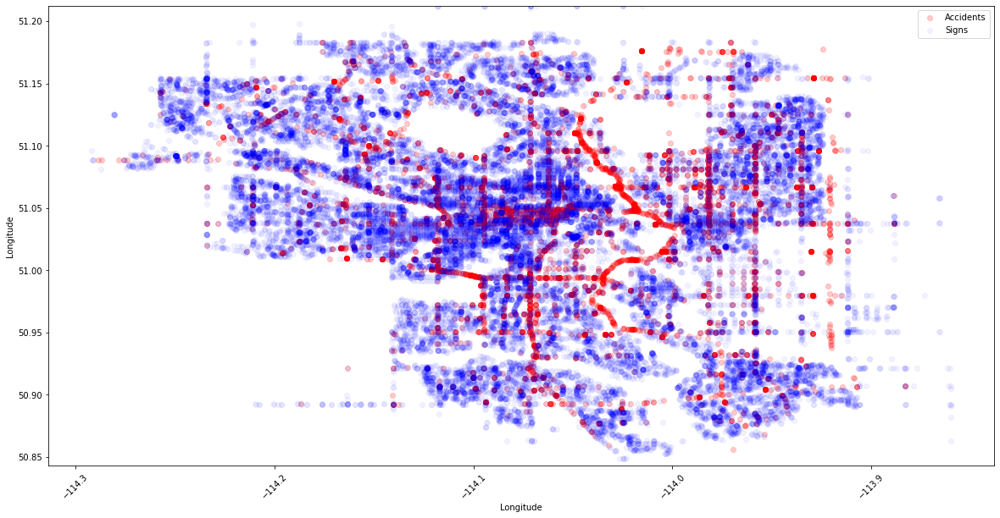

In [11]:
accidents = acc.extract_accidents('Data/Traffic_Incidents.csv', '2018')

plt.figure(figsize=(20,10))
plt.scatter(x = 'longitude', y = 'latitude', data = accidents, label = 'Accidents', c='r', alpha=0.2)
plt.scatter(x = 'longitude', y = 'latitude', data=df, label = 'Signs', c='b', alpha=0.05)
plt.ylim(50.842822, 51.212425)
plt.xticks(rotation=45)
plt.xlabel('Longitude')
plt.ylabel('Longitude')
plt.legend()

## Grid Analysis

In [31]:
sign_grid = ga.populate_grid(df)
sign_grid

array([[0.000e+00, 4.000e+00, 3.000e+01, 2.190e+02, 2.080e+02, 1.070e+02,
        7.000e+00, 1.000e+01, 0.000e+00, 0.000e+00],
       [0.000e+00, 3.830e+02, 3.480e+02, 5.490e+02, 8.620e+02, 9.560e+02,
        2.550e+02, 3.860e+02, 7.600e+01, 3.000e+00],
       [8.000e+00, 5.220e+02, 9.330e+02, 8.210e+02, 2.190e+02, 7.130e+02,
        4.400e+01, 5.950e+02, 8.250e+02, 0.000e+00],
       [3.800e+01, 2.040e+02, 8.760e+02, 9.280e+02, 1.007e+03, 1.524e+03,
        3.360e+02, 9.070e+02, 7.110e+02, 2.000e+00],
       [0.000e+00, 2.100e+01, 9.510e+02, 1.184e+03, 1.839e+03, 2.097e+03,
        7.990e+02, 1.143e+03, 5.290e+02, 4.100e+01],
       [0.000e+00, 1.900e+01, 3.040e+02, 5.900e+02, 1.288e+03, 1.150e+03,
        3.000e+02, 5.160e+02, 4.600e+01, 2.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 6.600e+01, 6.420e+02, 9.640e+02,
        7.070e+02, 3.220e+02, 9.300e+01, 4.500e+01],
       [0.000e+00, 0.000e+00, 0.000e+00, 1.070e+02, 6.130e+02, 6.320e+02,
        6.160e+02, 6.840e+02, 2.900e+

In [34]:
print('{:.0f} signs falls outside Calgary boundaries'.format(df.shape[0]-sign_grid.sum()))

8 signs falls outside Calgary boundaries


In [33]:
ga.display_grid_on_map(sign_grid[::-1].ravel(), 'sign count ')

# Conclusions
There is no clear correlation between traffic camera location and the number of accidents. 